# Style Transfer
> Artistic combination of two images
> - Layout of one image
> - Style of another

## Setup

In [1]:
import timm
import fastcore.all as fc

import torch
from torch import nn
from torch import tensor
import torch.nn.functional as F
import torchvision
from torch.utils.data import DataLoader

from minai.datasets import show_image, show_images
from minai.conv import def_device
from minai.learner import DataLoaders, TrainCB, ProgressCB, MetricsCB, DeviceCB, Learner, Callback, to_cpu
from minai.activations import HooksCallback, Hook, Hooks

/home/studio-lab-user/.conda/envs/fastai/lib/python3.9/site-packages/deeplake/util/check_latest_version.py:32: UserWarning: A newer version of deeplake (3.9.9) is available. It's recommended that you update to the latest version using `pip install -U deeplake`.
  warnings.warn(


In [2]:
# Image URLs for demos. Change as desired.
content_url = 'https://images.pexels.com/photos/20497642/pexels-photo-20497642/free-photo-of-two-motorboats-on-a-sea-by-the-mountains.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1'
style_url = 'https://images.pexels.com/photos/207142/pexels-photo-207142.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1'

## Loading images

In [3]:
def download_image(url):
    imgb = fc.urlread(url, decode=False)
    return torchvision.io.decode_image(tensor(list(imgb), dtype=torch.uint8)).float()/255

content_im.shape: torch.Size([3, 709, 1260])


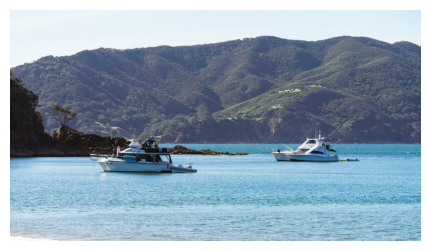

In [4]:
content_im = download_image(content_url).to(def_device)
print('content_im.shape:', content_im.shape)
show_image(content_im, figsize=(15, 3));

In [5]:
content_im.min(), content_im.max()

(tensor(0., device='cuda:0'), tensor(1., device='cuda:0'))

## Optimizing Images

In [6]:
class LengthDataset:
    def __init__(self, length=1): self.length = length
    def __len__(self): return self.length
    def __getitem__(self, idx): return 0, 0

def get_dummy_dls(length=100):
    return DataLoaders(DataLoader(LengthDataset(length), batch_size=1), # Train
                       DataLoader(LengthDataset(1), batch_size=1)) # Valid (length 1)

In [7]:
for batch in get_dummy_dls(10).train:
    print(batch)

[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]
[tensor([0]), tensor([0])]


In [8]:
class TensorModel(nn.Module):
    def __init__(self, t):
        super().__init__()
        self.t = nn.Parameter(t.clone())
    def forward(self, x=0): return self.t

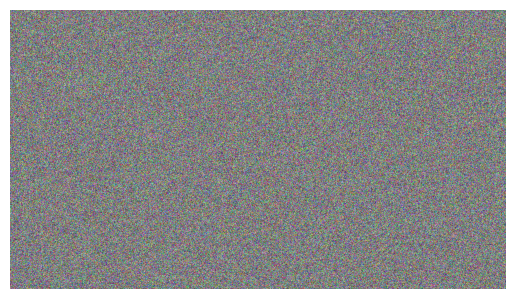

In [9]:
model = TensorModel(torch.rand_like(content_im))
show_image(model());

In [10]:
model.t.requires_grad

True

In [11]:
[p.shape for p in model.parameters()]

[torch.Size([3, 709, 1260])]

In [12]:
class ImageOptCB(TrainCB):
    def predict(self, learn): learn.preds = learn.model()
    def get_loss(self, learn): learn.loss = learn.loss_func(learn.preds)

In [13]:
def loss_fn_mse(im):
    return F.mse_loss(im, content_im)

model = TensorModel(torch.rand_like(content_im))
cbs = [ImageOptCB(), ProgressCB(), MetricsCB(), DeviceCB()]
learn = Learner(model, get_dummy_dls(100), loss_fn_mse, lr=1e-2, cbs=cbs, opt_func=torch.optim.Adam)
learn.fit(1)

loss,epoch,train
0.035,0,True
0.001,0,False


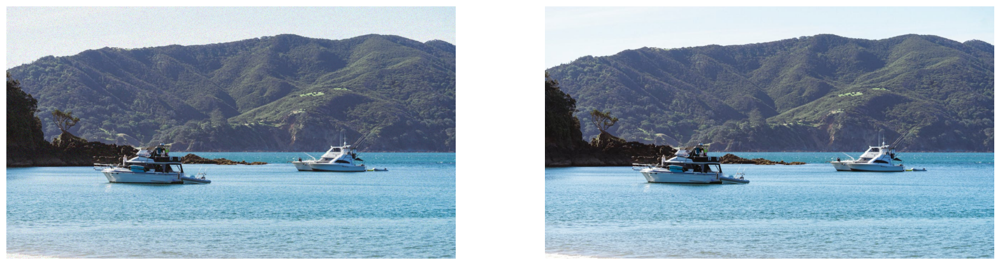

In [14]:
show_images([learn.model().clip(0, 1), content_im], imsize=10);

## Viewing progress

It would be great if we could see what is happening over time. You could save individual images and turn them into a video, but for quick feedback we can also log images every few iterations and display them in a grid `after_fit`:

In [15]:
class ImageLogCB(Callback):
    order = ProgressCB.order + 1
    def __init__(self, log_every=10): fc.store_attr(); self.images = []; self.i = 0
    def after_batch(self, learn):
        if self.i % self.log_every == 0: self.images.append(to_cpu(learn.preds.clip(0, 1)))
        self.i += 1
    def after_fit(self, learn): show_images(self.images, imsize=10)

loss,epoch,train
0.024,0,True
0.000,0,False


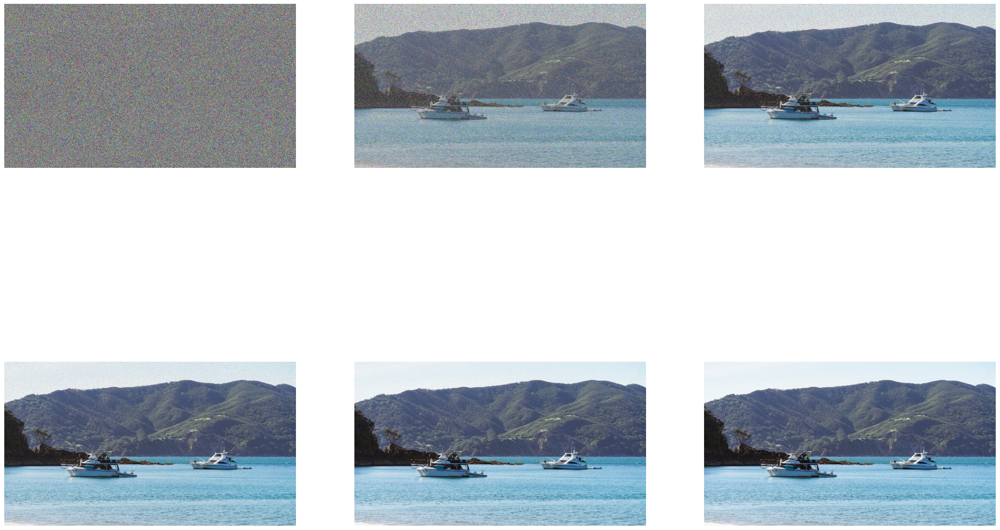

In [16]:
model = TensorModel(torch.rand_like(content_im))
learn = Learner(model, get_dummy_dls(150), loss_fn_mse, lr=1e-2, cbs=cbs, opt_func=torch.optim.Adam)
learn.fit(1, cbs=[ImageLogCB(30)])

## Getting Features from VGG16

We are going to peek inside a small CNN and extract the outputs of different layers.

### Load VGG network

![Alt text](https://camo.githubusercontent.com/d81273f3b627ff25df673e2dabb7206f9f0344abd05e60a61a8fd5c6c49b9565/68747470733a2f2f6e6575726f686976652e696f2f77702d636f6e74656e742f75706c6f6164732f323031382f31312f76676731362d312d65313534323733313230373137372e706e67)

In [17]:
print(timm.list_models('*vgg*'))

['repvgg_a0', 'repvgg_a1', 'repvgg_a2', 'repvgg_b0', 'repvgg_b1', 'repvgg_b1g4', 'repvgg_b2', 'repvgg_b2g4', 'repvgg_b3', 'repvgg_b3g4', 'repvgg_d2se', 'vgg11', 'vgg11_bn', 'vgg13', 'vgg13_bn', 'vgg16', 'vgg16_bn', 'vgg19', 'vgg19_bn']


In [18]:
vgg16 = timm.create_model('vgg16', pretrained=True).to(def_device).features

#### Normalize image

This model expects images normalized with the same stats as those used during training, which in this case requires the stats of the ImageNet dataset. Previously we were building with single-channel images, and so normalizing was pretty straightforward. With three channels, we need to think a bit more about shapes and broadcasting rules:

In [19]:
imagenet_mean = tensor([0.485, 0.456, 0.406])
imagenet_std = tensor([0.229, 0.224, 0.225])

In [20]:
# Try 1 (wont work)
# (content_im - imagenet_mean) / imagenet_std

In [21]:
imagenet_mean.shape

torch.Size([3])

In [22]:
content_im.shape

torch.Size([3, 709, 1260])

In [23]:
imagenet_mean[:, None, None].shape

torch.Size([3, 1, 1])

In [24]:
# Try 2:
def normalize(im):
    imagenet_mean = tensor([0.485, 0.456, 0.406])[:, None, None].to(im.device)
    imagenet_std = tensor([0.229, 0.224, 0.225])[:, None, None].to(im.device)
    return (im - imagenet_mean) / imagenet_std

In [25]:
normalize(content_im).min(), normalize(content_im).max()

(tensor(-2.12, device='cuda:0'), tensor(2.64, device='cuda:0'))

In [26]:
normalize(content_im).mean(dim = (1, 2)), normalize(content_im).std(dim=(1, 2))

(tensor([0.05, 0.58, 1.12], device='cuda:0'),
 tensor([1.04, 1.15, 1.12], device='cuda:0'))

In [27]:
# And with torch vision transforms:
normalize = torchvision.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

In [28]:
normalize(content_im).min(), normalize(content_im).max()

(tensor(-2.12, device='cuda:0'), tensor(2.64, device='cuda:0'))

#### Get intermediate representations, take 1:

We want to feed some data through the network, storing the outputs of different layers. Here's one way to do this:

In [29]:
def calc_features(imgs, target_layers=(18, 25)):
    x = normalize(imgs)
    feats = []
    for i, layer in enumerate(vgg16[:max(target_layers) + 1]):
        x = layer(x)
        if i in target_layers:
            feats.append(x.clone())
    return feats

In [30]:
feats = calc_features(content_im)
[f.shape for f in feats]

[torch.Size([512, 88, 157]), torch.Size([512, 44, 78])]

##### Using hook context manager

In [31]:
def collect_feature(hook, mod, inp, outp):
    hook.feats = outp.clone()

In [32]:
target_layers = (18, 25)
ms = fc.L(vgg16)[target_layers]
with Hooks(ms, collect_feature) as hooks:
    x = normalize(content_im)
    x = vgg16(x)
    feats_hooks = [h.feats for h in hooks]

In [33]:
[f.shape for f in feats_hooks]

[torch.Size([512, 88, 157]), torch.Size([512, 44, 78])]

### What is the point?

You may remember us looking at https://distill.pub/2017/feature-visualization/ and talking about how deep CNNs `learn` to classify images. Early layers tend to capture gradients and textures, while later layers tend towards more complex type of feature. We are going to exploit this hierarchy for artistic purpose, but being able to choose what kind of feature you would like to use when comparing images has a number of other useful applications.

### Optimizing an Image with Content Loss

To start with let's try optimizing an image by comparing its features (from two layers) with those from the target image. If our theory is right, we should see the structure of the target emerge from the noise without necessarily seeing a perfect re-production of the target like we did in previous MSE loss example.

In [34]:
class ContentLossToTarget:
    def __init__(self, target_im, target_layers=(18, 25)):
        fc.store_attr()
        with torch.no_grad():
            self.target_features = calc_features(target_im, target_layers)
    
    def __call__(self, input_im):
        return sum((f1-f2).pow(2).mean() for f1, f2 in zip(calc_features(input_im, self.target_layers), self.target_features))

loss,epoch,train
1.783,0,True
0.623,0,False


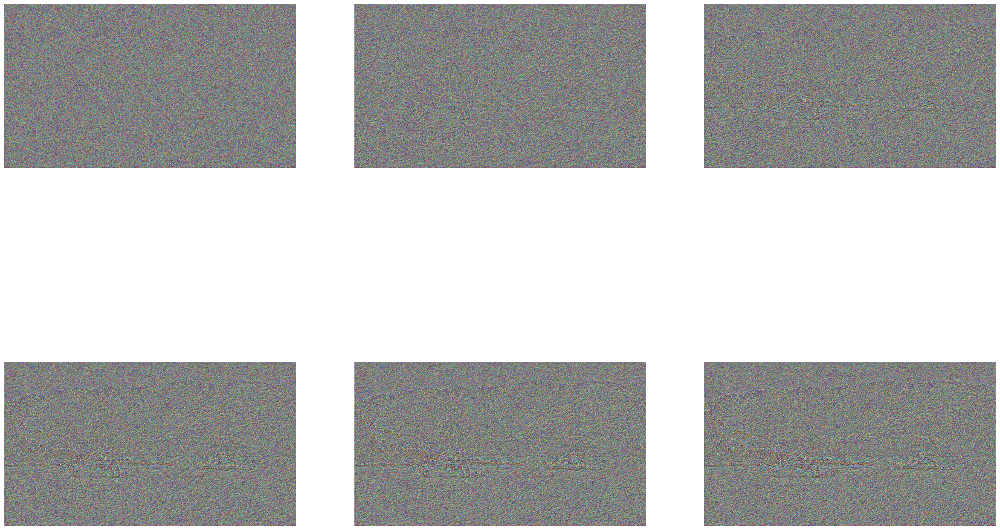

In [35]:
loss_function_perceptual = ContentLossToTarget(content_im)
model = TensorModel(torch.rand_like(content_im))
learn = Learner(model, get_dummy_dls(150), loss_function_perceptual, lr=1e-2, cbs=cbs, opt_func=torch.optim.Adam)
learn.fit(1, cbs=[ImageLogCB(log_every=30)])

#### Choosing the layers determine the kind of features that are important:

loss,epoch,train
2.033,0,True
0.232,0,False


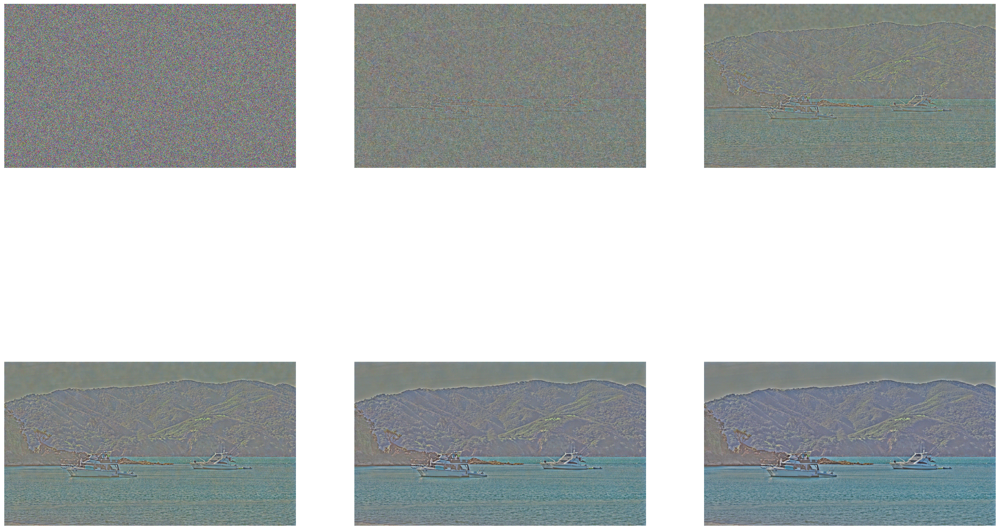

In [36]:
loss_function_perceptual = ContentLossToTarget(content_im, target_layers=(1, 6))
model = TensorModel(torch.rand_like(content_im))
learn = Learner(model, get_dummy_dls(150), loss_function_perceptual, lr=1e-2, cbs=cbs, opt_func=torch.optim.Adam)
learn.fit(1, cbs=[ImageLogCB(log_every=30)])

### Style Loss with Gram Matrix

So, we know how to extract feature maps. The next thing we would like to do is find a way to capture the style of an input image, based on those early layers and the kinds of textual feature that they learn. Unfortunately, we cant just compare the feature maps from early layers since these `maps` encode information spatially - which we dont want!

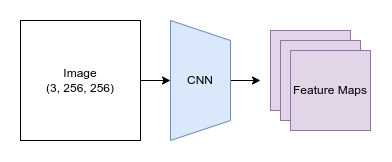

So, we need a way to measure what **kinds** of style features are present, and ideally which kinds occur together, without worrying about **where** these features occur in image

Enter something called the Gram Matrix. The idea here is that we will measure the **correlation** between features. Given a feature map with f features in an `h` x `w` grid, we will flatten out the spatial component and then for every feature we will take the dot product of that row with itself, giving an `f` x `f` matrix as the result. Each entry in this matrix qualifies how correlated the relevant pair of features are and how frequently are and how frequently they occur -  exactly what we want. In this diagram each feature is represented as colored dot.

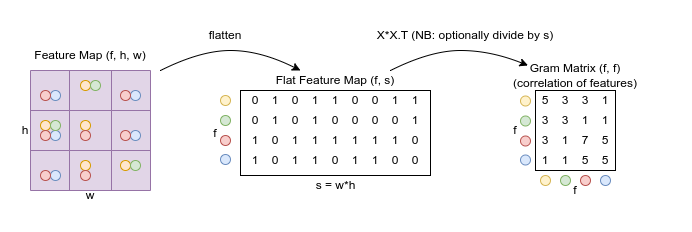

Re-creating the diagram operations in code:

In [37]:
t = tensor([[0, 1, 0, 1, 1, 0, 0, 1, 1],
            [0, 1, 0, 1, 0, 0, 0, 0, 1],
            [1, 0, 1, 1, 1, 1, 1, 1, 0],
            [1, 0, 1, 1, 0, 1, 1, 0, 0]])

In [38]:
torch.einsum('fs, gs -> fg', t, t)

tensor([[5, 3, 3, 1],
        [3, 3, 1, 1],
        [3, 1, 7, 5],
        [1, 1, 5, 5]])

In [39]:
t.matmul(t.T) # Alternate approach

tensor([[5, 3, 3, 1],
        [3, 3, 1, 1],
        [3, 1, 7, 5],
        [1, 1, 5, 5]])

### Trying it out

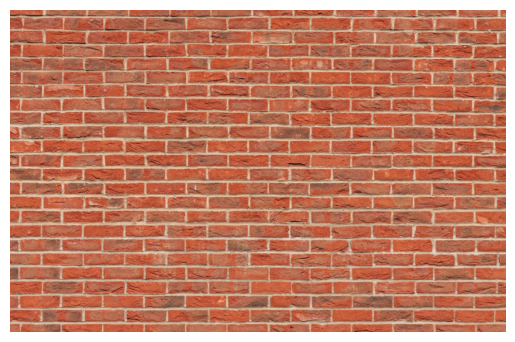

In [40]:
style_im = download_image(style_url).to(def_device)
show_image(style_im);

In [41]:
style_im.size()

torch.Size([3, 750, 1154])

In [42]:
def calc_grams(img, target_layers=(1, 6, 11, 18, 25)):
    return fc.L(torch.einsum('chw, dhw -> cd', x, x) / (x.shape[-2] * x.shape[-1]) for x in calc_features(img, target_layers)) # Scaling because we may pass images of different sizes

In [43]:
style_grams = calc_grams(style_im)

In [44]:
[g.shape for g in style_grams]

[torch.Size([64, 64]),
 torch.Size([128, 128]),
 torch.Size([256, 256]),
 torch.Size([512, 512]),
 torch.Size([512, 512])]

In [45]:
style_grams.attrgot('shape')

(#5) [torch.Size([64, 64]),torch.Size([128, 128]),torch.Size([256, 256]),torch.Size([512, 512]),torch.Size([512, 512])]

In [46]:
class StyleLossToTarget:
    def __init__(self, target_im, target_layers=(1, 6, 11, 18, 25)):
        fc.store_attr()
        with torch.no_grad(): self.target_grams = calc_grams(target_im, target_layers)
    
    def __call__(self, input_im):
        return sum((f1 - f2).pow(2).mean() for f1, f2 in zip(calc_grams(input_im, self.target_layers), self.target_grams))

In [47]:
style_loss = StyleLossToTarget(style_im)

In [48]:
style_loss(content_im)

tensor(12.44, device='cuda:0', grad_fn=<AddBackward0>)

## Style Transfer

loss,epoch,train
5.802,0,True
4.921,0,False


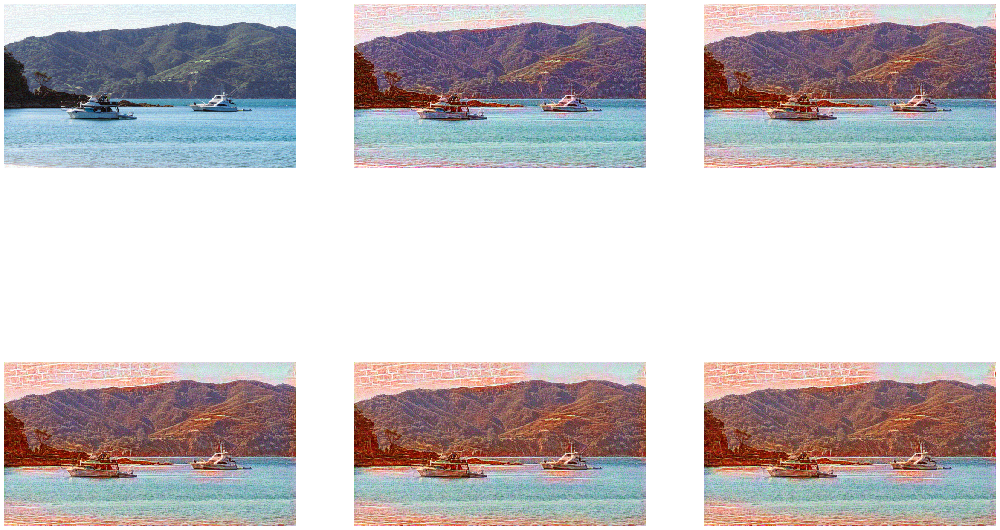

In [54]:
model = TensorModel(content_im) # Start from content image
style_loss = StyleLossToTarget(style_im)
content_loss = ContentLossToTarget(content_im)

def combined_loss(x):
    return style_loss(x) + content_loss(x)

learn = Learner(model, get_dummy_dls(300), combined_loss, lr=5e-2, cbs=cbs, opt_func=torch.optim.Adam)
learn.fit(1, cbs=[ImageLogCB(60)])

<AxesSubplot: >

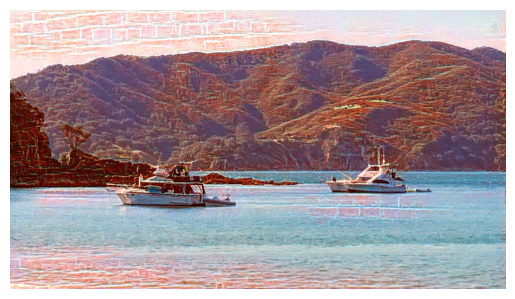

In [50]:
show_image(learn.model().clip(0, 1))

And trying with random starting image, weighting the style loss lower, using different layers

loss,epoch,train
17.111,0,True
6.578,0,False


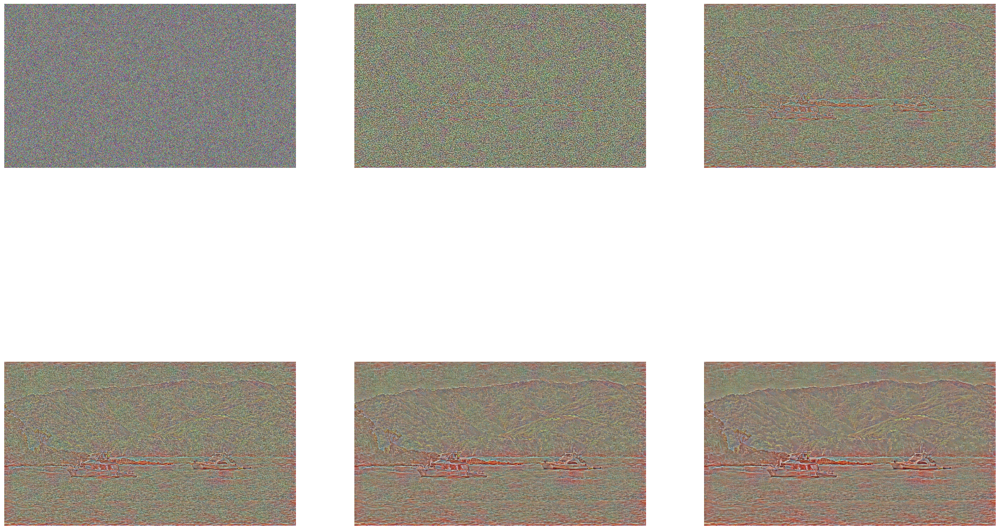

In [59]:
model = TensorModel(torch.rand_like(content_im))
style_loss = StyleLossToTarget(style_im)
content_loss = ContentLossToTarget(content_im, target_layers=(6, 18, 25))

def combined_loss(x):
    return style_loss(x) * 0.8  + content_loss(x)

learn = Learner(model, get_dummy_dls(300), combined_loss, lr=5e-2, cbs=cbs, opt_func=torch.optim.Adam)
learn.fit(1, cbs=[ImageLogCB(60)])

## For comparision: non-minai version 

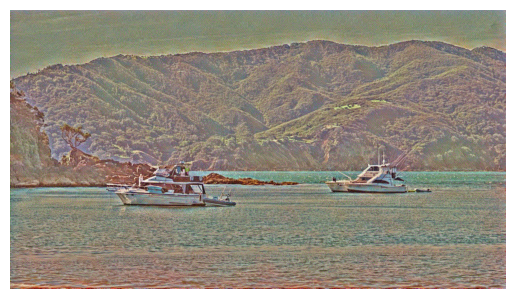

In [60]:
# the image to be optimized
im = torch.rand_like(content_im).to(def_device)
im.requires_grad = True

# Set up the optimizer
opt = torch.optim.Adam([im], lr=5e-2)

# Define the loss function
style_loss = StyleLossToTarget(style_im)
content_loss = ContentLossToTarget(content_im, target_layers=(6, 18, 25))
def combined_loss(x): return style_loss(x) * 0.2 + content_loss(x)

for i in range(300):
    loss = combined_loss(im)
    loss.backward()
    opt.step()
    opt.zero_grad()

show_image(im.clip(0, 1));